In [110]:
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

import json

import geopandas as gpd
import numpy as np
import pandas as pd
import seaborn as sbn

sbn.set_palette('colorblind')
%matplotlib inline

Our dataset

In [2]:
with open('/Volumes/thesis-data/dtype_dict.json') as f:
    dtypes = json.load(f)

df = pd.read_csv('/Volumes/thesis-data/main.csv', dtype=dtypes,
                 parse_dates=['PERIOD', 'ADMDATE', 'DISCDATE'])

The practice code conversion dataset

In [3]:
practices = pd.read_csv('../rsc/practice_codes.csv')

Extract our practice codes

In [4]:
observed_practice_codes = df['practice_code'].dropna().values
known_practice_codes = [c for c in observed_practice_codes if c in practices['PracticeCode'].values]

our_practices = practices.set_index('PracticeCode').loc[known_practice_codes].reset_index()
our_practices['District'] = our_practices['Postcode'].map(lambda x: str(x).split()[0])

Postcode datasets, and extracting just the Welsh one

In [5]:
areas = gpd.read_file('/Users/henrywilde/Distribution/Areas.shp')
districts = gpd.read_file('/Users/henrywilde/Distribution/Districts.shp')
sectors = gpd.read_file('/Users/henrywilde/Distribution/Sectors.shp')

In [6]:
our_district_codes = our_practices['District'].unique()
districts['postcode_area'] = districts['name'].apply(lambda x: str(x)[:2])

welsh_areas = areas.set_index('name').loc[['CF', 'CH', 'HR', 'NP', 'GL', 'LD', 'LL', 'SA', 'SY']].reset_index()
wales = districts.set_index('postcode_area').loc[['CF', 'CH', 'HR', 'NP', 'GL', 'LD', 'LL', 'SA', 'SY']]
our_districts = districts.set_index('name').loc[our_district_codes].reset_index()

welsh_areas['centroid'] = welsh_areas['geometry'].centroid
wales['centroid'] = wales['geometry'].centroid

The 2011 LSOA codes, restricted to those in Wales

In [7]:
lsoas = gpd.read_file('/Users/henrywilde/LSOA_2011/Lower_Layer_Super_Output_Areas_December_2011_Full_Extent__Boundaries_in_England_and_Wales.shp')
lsoas = lsoas.to_crs(wales.crs).loc[lsoas['lsoa11cd'].str.get(0) == 'W']

lsoas['County'] = lsoas.apply(lambda x: ' '.join(x['lsoa11nm'].split(' ')[:-1]), axis=1)

Map out the counties of Wales

In [8]:
counties = lsoas.dissolve(by='County')

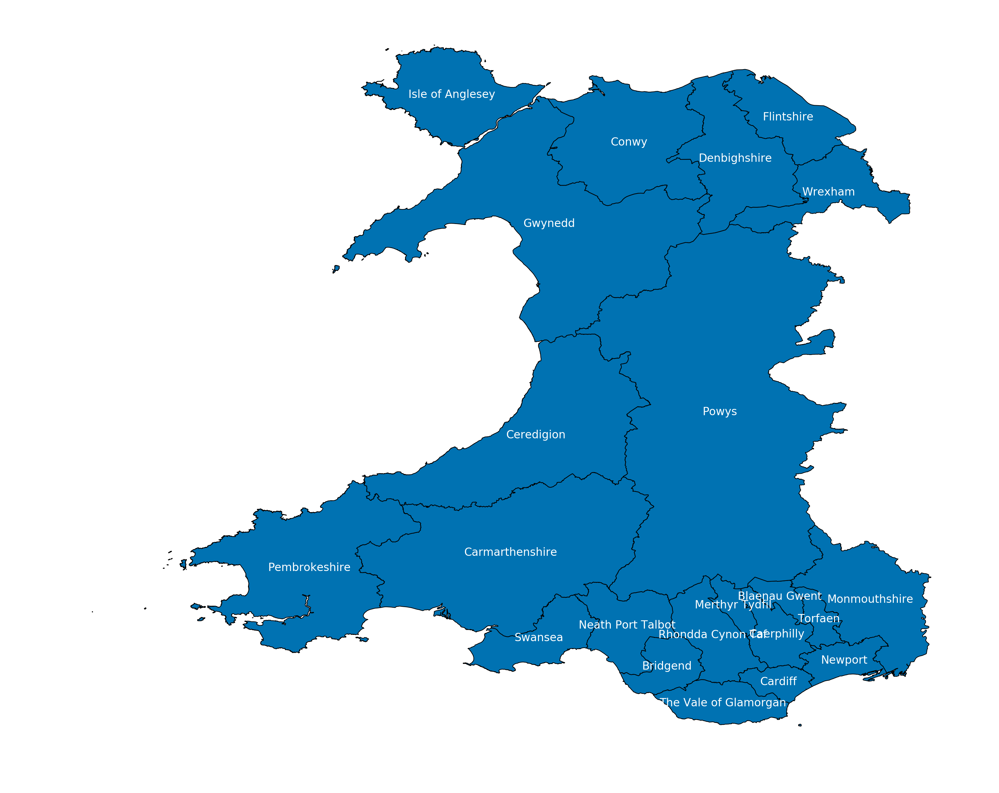

In [9]:
fig, ax = plt.subplots(1, figsize=(12, 10), dpi=300)

counties.plot(ax=ax, edgecolor='k', lw=0.5)

for county in counties.iterrows():
    ax.text(county[1]['geometry'].centroid.x,
            county[1]['geometry'].centroid.y,
            county[0], color='white', fontsize=8,
            horizontalalignment='center',
            verticalalignment='center'
    )

ax.axis('off');

In [10]:
cwmtaf_lsoas = lsoas[lsoas['County'].isin(['Merthyr Tydfil', 'Rhondda Cynon Taf'])]
cwmtaf_counties = cwmtaf_lsoas.dissolve(by='County')

In [11]:
wimd_ranks = pd.read_csv('/Users/henrywilde/WIMD.csv')

cwmtaf_lsoas.set_index('lsoa11cd', inplace=True)
for col in wimd_ranks.columns:
    if col not in ['LSOA11', 'LSOA11CD', 'county']:
        cwmtaf_lsoas[col] = wimd_ranks.set_index('LSOA11CD')[col]
cwmtaf_lsoas.reset_index(inplace=True)

/Users/henrywilde/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


Postcode conversion, and Cwm Taf specifically

In [12]:
conversions = pd.read_csv('/Users/henrywilde/PCDtoOA.csv', low_memory=False)
cwmtaf_conversions = conversions[conversions['LAD11NM'].isin(cwmtaf_lsoas['County'].unique())]

In [13]:
hospital_names = ['PCH', 'RGH', 'DSH']
hospital_PCDs = ['CF47 9DT', 'CF72 8XR', 'CF37 1EB']
hospital_codes = cwmtaf_conversions.set_index('PCD8').loc[hospital_PCDs]['LSOA11CD'].values

centroids = cwmtaf_lsoas.set_index('lsoa11cd').loc[hospital_codes]['geometry'].centroid
hospital_locs = gpd.GeoDataFrame({'name': hospital_names, 'centroid': centroids})

In [14]:
index_components = np.array([c for c in wimd_ranks.columns if c not in ['county', 'LSOA11', 'LSOA11CD']])

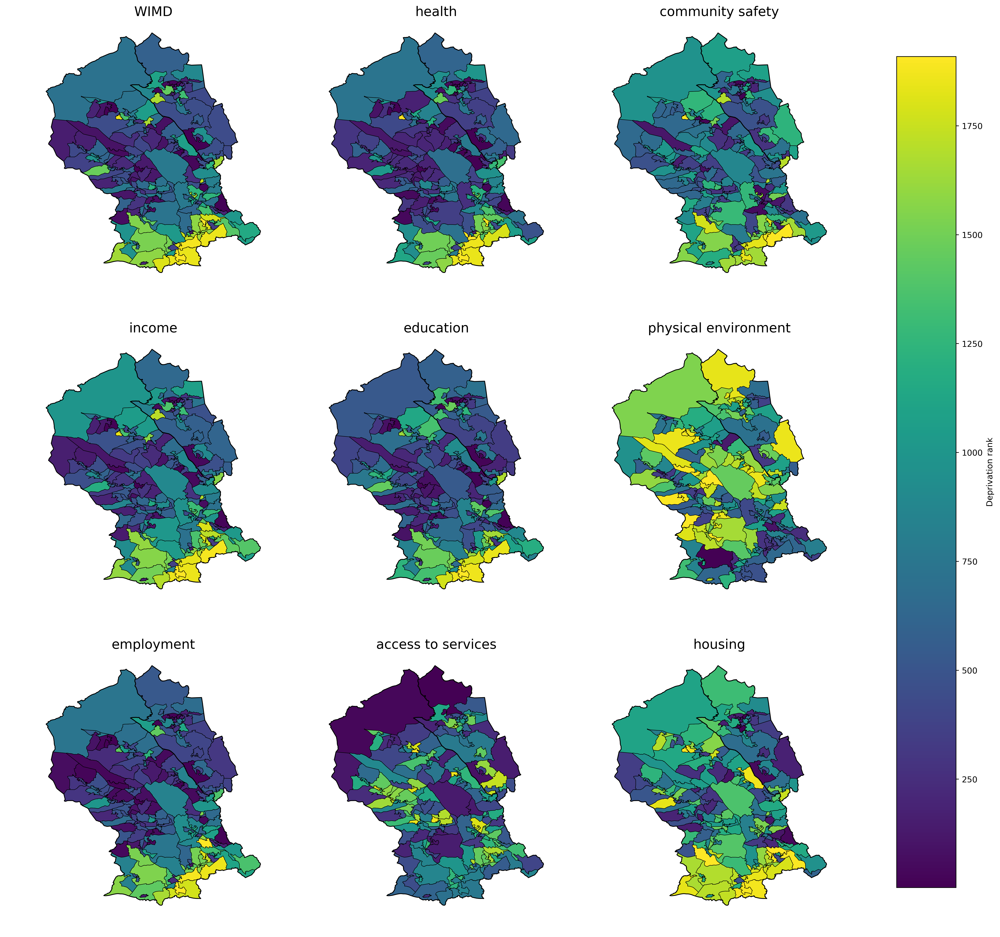

In [60]:
fig, axes = plt.subplots(nrows=3, ncols=3, figsize=(20, 20), dpi=400)

vmin = 1
vmax = 1909

for col, component_col in zip(axes.T, index_components.reshape(3, 3)):
    i = 0
    for ax in col:
        component = component_col[i]
        cwmtaf_lsoas.plot(component, ax=ax, cmap='viridis', edgecolor='k', lw=0.5)
        cwmtaf_counties.plot(ax=ax, facecolor='None', edgecolor='k', lw=1)

        ax.axis('off')
        ax.set_title(component.replace('_', ' '), fontsize=16)
        i += 1

fig.subplots_adjust(right=0.8)
cbar_ax = fig.add_axes([0.85, 0.15, 0.05, 0.7])
sm = plt.cm.ScalarMappable(cmap='viridis', norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm._A = []
cbar = fig.colorbar(sm, cax=cbar_ax, label='Deprivation rank');

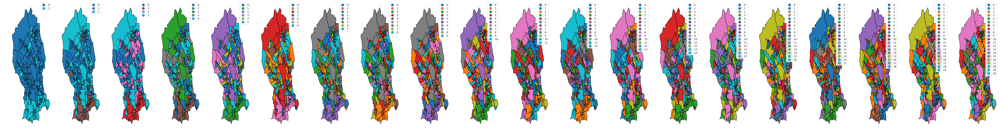

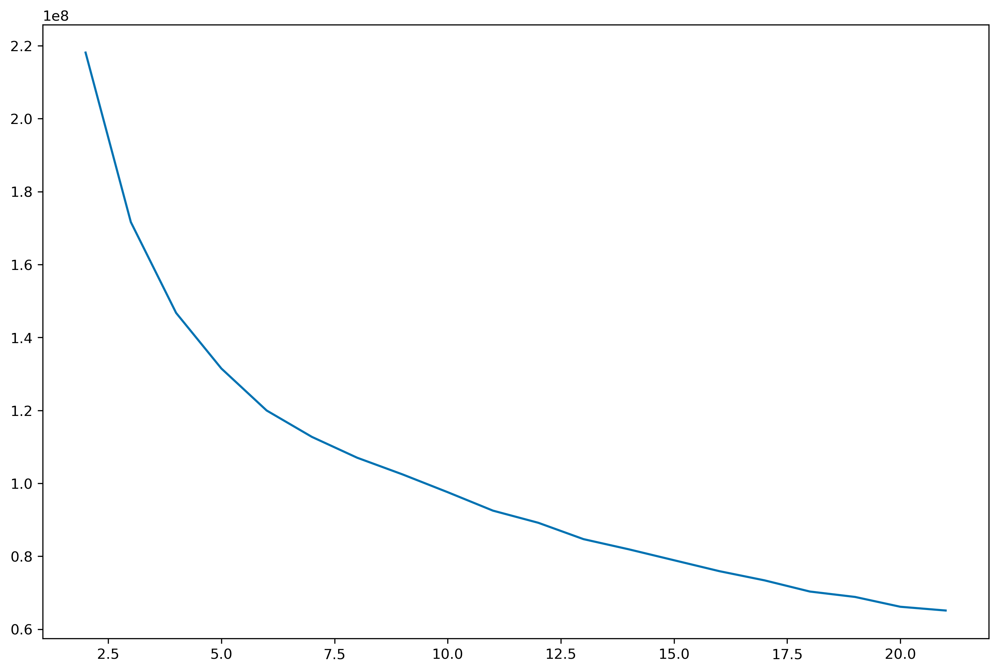

In [135]:
max_col = 20
fig, axes = plt.subplots(nrows=1, ncols=max_col, figsize=(75, 10), dpi=300)
np.random.seed(1234)

costs = []
for i, ax in enumerate(axes):
    n_clusters = i + 2
    km = KMeans(n_clusters=n_clusters)
    km_clusters = km.fit(cwmtaf_lsoas[index_components].values)

    cwmtaf_lsoas.assign(cl=km_clusters.labels_)\
                .plot(column='cl', categorical=True, legend=True,\
                      edgecolor='k', ax=ax)
    cwmtaf_counties.plot(facecolor='None', edgecolor='k', ax=ax)
    costs.append(km.inertia_)
    ax.axis('off')

fig, ax = plt.subplots(1, figsize=(12, 8), dpi=300)

ax.plot(np.arange(max_col) + 2, costs);

In [87]:
cwmtaf_lsoa_centroids = gpd.GeoDataFrame(cwmtaf_lsoas['centroid'])
cwmtaf_lsoa_centroids.rename({'centroid': 'geometry'}, axis=1, inplace=True)

In [154]:
cwmtaf_sectors = gpd.read_file('/Users/henrywilde/cwmtaf_sectors.shp')

In [152]:
cwmtaf_sectors

,name,index_righ,lsoa11cd,objectid,lsoa11nm,lsoa11nmw,st_areasha,st_lengths,County,WIMD,income,employment,health,education,access_to_,community_,physical_e,housing,geometry
0,CF15 7,103,W01001241,34113,Rhondda Cynon Taf 026D,Rhondda Cynon Taf 026D,1.271559e+06,7067.257171,Rhondda Cynon Taf,1081.500000,1234.500000,1224.500000,759.000000,995.000000,729.500000,988.000000,605.500000,828.500000,"POLYGON ((-3.254480042371113 51.5278904109964,..."
1,CF15 9,103,W01001241,34113,Rhondda Cynon Taf 026D,Rhondda Cynon Taf 026D,1.271559e+06,7067.257171,Rhondda Cynon Taf,1362.000000,1439.000000,1103.000000,1014.000000,1082.000000,875.000000,1643.000000,635.000000,1896.000000,POLYGON ((-3.296439077227054 51.55996206258983...
2,CF83 1,103,W01001241,34113,Rhondda Cynon Taf 026D,Rhondda Cynon Taf 026D,1.271559e+06,7067.257171,Rhondda Cynon Taf,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,POLYGON ((-3.200407915991383 51.56147299188583...
3,CF15 7,102,W01001240,34112,Rhondda Cynon Taf 026C,Rhondda Cynon Taf 026C,5.451507e+06,13609.223848,Rhondda Cynon Taf,1081.500000,1234.500000,1224.500000,759.000000,995.000000,729.500000,988.000000,605.500000,828.500000,"POLYGON ((-3.254480042371113 51.5278904109964,..."
4,CF37 5,102,W01001240,34112,Rhondda Cynon Taf 026C,Rhondda Cynon Taf 026C,5.451507e+06,13609.223848,Rhondda Cynon Taf,365.800000,389.800000,356.800000,307.600000,304.000000,1085.800000,501.200000,694.400000,817.000000,POLYGON ((-3.317341905335796 51.58582979853885...
5,CF83 1,102,W01001240,34112,Rhondda Cynon Taf 026C,Rhondda Cynon Taf 026C,5.451507e+06,13609.223848,Rhondda Cynon Taf,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,POLYGON ((-3.200407915991383 51.56147299188583...
6,CF15 7,106,W01001244,34116,Rhondda Cynon Taf 025B,Rhondda Cynon Taf 025B,3.628621e+06,13657.820132,Rhondda Cynon Taf,1081.500000,1234.500000,1224.500000,759.000000,995.000000,729.500000,988.000000,605.500000,828.500000,"POLYGON ((-3.254480042371113 51.5278904109964,..."
7,CF15 9,106,W01001244,34116,Rhondda Cynon Taf 025B,Rhondda Cynon Taf 025B,3.628621e+06,13657.820132,Rhondda Cynon Taf,1362.000000,1439.000000,1103.000000,1014.000000,1082.000000,875.000000,1643.000000,635.000000,1896.000000,POLYGON ((-3.296439077227054 51.55996206258983...
8,CF37 5,106,W01001244,34116,Rhondda Cynon Taf 025B,Rhondda Cynon Taf 025B,3.628621e+06,13657.820132,Rhondda Cynon Taf,365.800000,389.800000,356.800000,307.600000,304.000000,1085.800000,501.200000,694.400000,817.000000,POLYGON ((-3.317341905335796 51.58582979853885...
9,CF38 1,106,W01001244,34116,Rhondda Cynon Taf 025B,Rhondda Cynon Taf 025B,3.628621e+06,13657.820132,Rhondda Cynon Taf,1456.285714,1435.857143,1343.857143,1313.857143,1282.000000,1411.285714,1250.000000,545.571429,1542.857143,POLYGON ((-3.296439077227056 51.55996206258983...


In [144]:
sectors = sectors.to_crs(lsoas.crs)
cwmtaf_sectors = gpd.tools.sjoin(cwmtaf_sectors, cwmtaf_lsoa_centroids, how='inner', op='intersects')
cwmtaf_districts = gpd.tools.sjoin(wales, cwmtaf_lsoa_centroids, how='inner', op='intersects')

In [150]:
cwmtaf_sectors.rename({'access_to_': 'access_to_services',
                       'community_': 'community_safety',
                       'physical_e': 'physical_environment'}, axis=1)

,name,index_righ,lsoa11cd,objectid,lsoa11nm,lsoa11nmw,st_areasha,st_lengths,County,WIMD,...,employment,health,education,access_to_services,community_safety,physical_environment,housing,geometry,index_right,District
0,CF15 7,103,W01001241,34113,Rhondda Cynon Taf 026D,Rhondda Cynon Taf 026D,1.271559e+06,7067.257171,Rhondda Cynon Taf,1081.500000,...,1224.500000,759.000000,995.000000,729.500000,988.000000,605.500000,828.500000,"POLYGON ((-3.254480042371113 51.5278904109964,...",103,CF15
3,CF15 7,102,W01001240,34112,Rhondda Cynon Taf 026C,Rhondda Cynon Taf 026C,5.451507e+06,13609.223848,Rhondda Cynon Taf,1081.500000,...,1224.500000,759.000000,995.000000,729.500000,988.000000,605.500000,828.500000,"POLYGON ((-3.254480042371113 51.5278904109964,...",103,CF15
6,CF15 7,106,W01001244,34116,Rhondda Cynon Taf 025B,Rhondda Cynon Taf 025B,3.628621e+06,13657.820132,Rhondda Cynon Taf,1081.500000,...,1224.500000,759.000000,995.000000,729.500000,988.000000,605.500000,828.500000,"POLYGON ((-3.254480042371113 51.5278904109964,...",103,CF15
10,CF15 7,46,W01001184,34056,Rhondda Cynon Taf 026A,Rhondda Cynon Taf 026A,4.099568e+06,15574.928405,Rhondda Cynon Taf,1081.500000,...,1224.500000,759.000000,995.000000,729.500000,988.000000,605.500000,828.500000,"POLYGON ((-3.254480042371113 51.5278904109964,...",103,CF15
0,CF15 7,103,W01001241,34113,Rhondda Cynon Taf 026D,Rhondda Cynon Taf 026D,1.271559e+06,7067.257171,Rhondda Cynon Taf,1081.500000,...,1224.500000,759.000000,995.000000,729.500000,988.000000,605.500000,828.500000,"POLYGON ((-3.254480042371113 51.5278904109964,...",102,CF15
3,CF15 7,102,W01001240,34112,Rhondda Cynon Taf 026C,Rhondda Cynon Taf 026C,5.451507e+06,13609.223848,Rhondda Cynon Taf,1081.500000,...,1224.500000,759.000000,995.000000,729.500000,988.000000,605.500000,828.500000,"POLYGON ((-3.254480042371113 51.5278904109964,...",102,CF15
6,CF15 7,106,W01001244,34116,Rhondda Cynon Taf 025B,Rhondda Cynon Taf 025B,3.628621e+06,13657.820132,Rhondda Cynon Taf,1081.500000,...,1224.500000,759.000000,995.000000,729.500000,988.000000,605.500000,828.500000,"POLYGON ((-3.254480042371113 51.5278904109964,...",102,CF15
10,CF15 7,46,W01001184,34056,Rhondda Cynon Taf 026A,Rhondda Cynon Taf 026A,4.099568e+06,15574.928405,Rhondda Cynon Taf,1081.500000,...,1224.500000,759.000000,995.000000,729.500000,988.000000,605.500000,828.500000,"POLYGON ((-3.254480042371113 51.5278904109964,...",102,CF15
1,CF15 9,103,W01001241,34113,Rhondda Cynon Taf 026D,Rhondda Cynon Taf 026D,1.271559e+06,7067.257171,Rhondda Cynon Taf,1362.000000,...,1103.000000,1014.000000,1082.000000,875.000000,1643.000000,635.000000,1896.000000,POLYGON ((-3.296439077227054 51.55996206258983...,106,CF15
7,CF15 9,106,W01001244,34116,Rhondda Cynon Taf 025B,Rhondda Cynon Taf 025B,3.628621e+06,13657.820132,Rhondda Cynon Taf,1362.000000,...,1103.000000,1014.000000,1082.000000,875.000000,1643.000000,635.000000,1896.000000,POLYGON ((-3.296439077227054 51.55996206258983...,106,CF15


In [146]:
cwmtaf_sectors['District'] = cwmtaf_sectors['name'].apply(lambda x: str(x).split()[0])

In [147]:
cwmtaf_sectors.groupby('District')[index_components].mean()

KeyError: "Columns not found: 'access_to_services', 'physical_environment', 'community_safety'"

In [136]:
cwmtaf_districts['name'].unique()

array(['CF15', 'CF35', 'CF37', 'CF38', 'CF39', 'CF40', 'CF41', 'CF42',
       'CF43', 'CF44', 'CF45', 'CF46', 'CF47', 'CF48', 'CF72'],
      dtype=object)

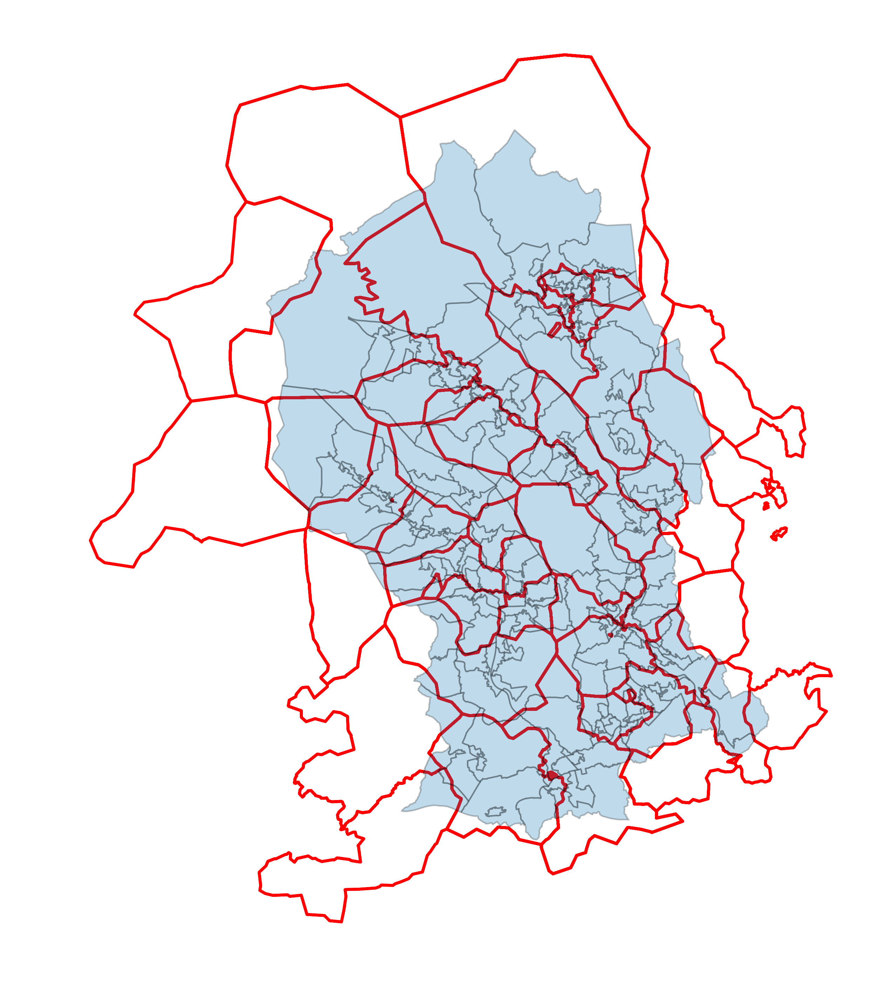

In [194]:
fig, ax = plt.subplots(1, figsize=(10, 12), dpi=300)

cwmtaf_sectors.plot(ax=ax, facecolor='None', edgecolor='red', lw=2)
# cwmtaf_districts.plot(ax=ax, facecolor='grey', alpha=0.5)
cwmtaf_lsoas.plot(ax=ax, edgecolor='k', alpha=0.25)

# for point in cwmtaf_lsoa_centroids['geometry']:
#     ax.scatter(point.x, point.y, marker='.', color='k')
# for point in cwmtaf_sectors.iterrows():
#     ax.text(point[1]['geometry'].centroid.x,
#             point[1]['geometry'].centroid.y,
#             point[1]['name'], color='red',
#             horizontalalignment='center',
#             verticalalignment='center')

ax.axis('off');

In [155]:
components = {idx: [[] for _ in range(len(cwmtaf_sectors))] for idx in index_components}
for sector_idx in range(len(cwmtaf_sectors)):
    sector = cwmtaf_sectors.iloc[sector_idx]
    for lsoa_idx in range(len(cwmtaf_lsoas)):
        lsoa = cwmtaf_lsoas.iloc[lsoa_idx]
        if lsoa['centroid'].within(sector['geometry']):
            for comp in index_components:
                components[comp][sector_idx] += [lsoa[comp]]

In [156]:
for key, val in components.items():
    cwmtaf_sectors[key] = val

In [157]:
components = {idx: [] for idx in index_components}
for sector_idx in range(len(cwmtaf_sectors)):
    sector = cwmtaf_sectors.iloc[sector_idx]
    for component in index_components:
        components[component] += [np.mean(sector[component])]

/Users/henrywilde/anaconda3/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2957: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/henrywilde/anaconda3/lib/python3.6/site-packages/numpy/core/_methods.py:80: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


In [158]:
for key, val in components.items():
    cwmtaf_sectors[key] = val

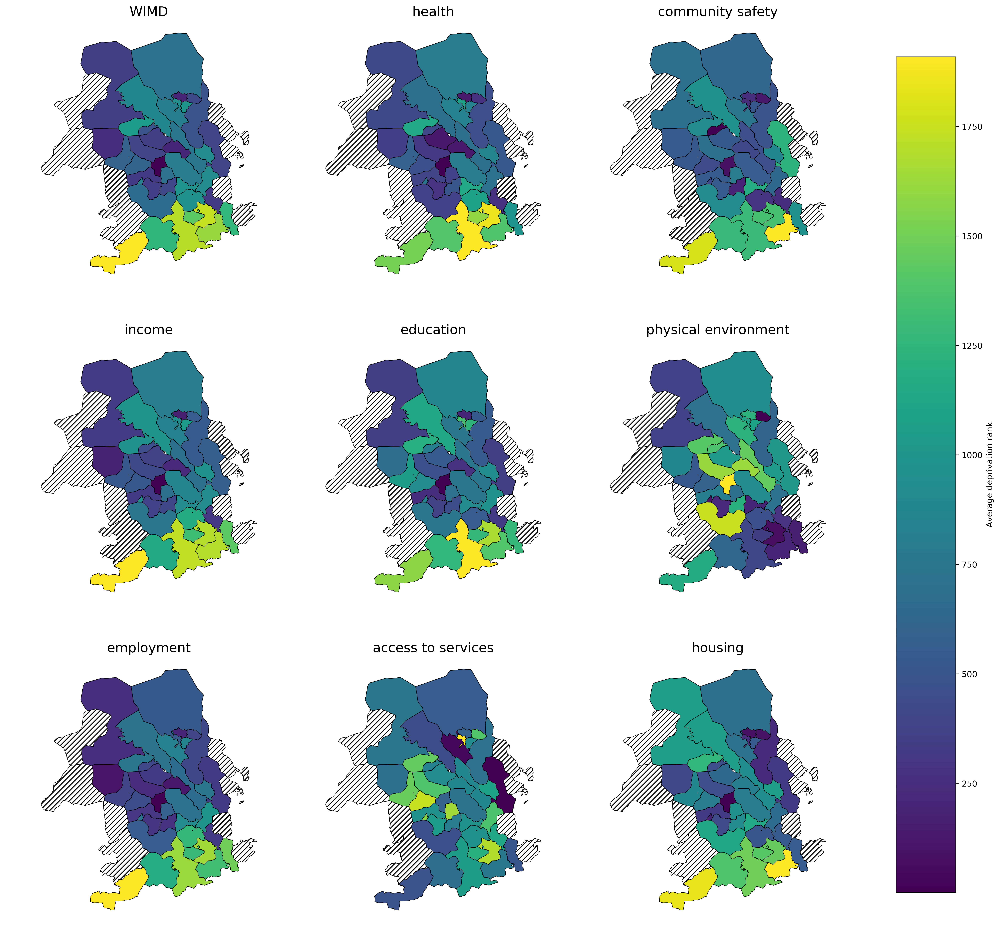

In [179]:
fig, axes = plt.subplots(nrows=3, ncols=3, figsize=(20, 20), dpi=400)

vmin = 1
vmax = 1909

fig.subplots_adjust(right=0.8)
cbar_ax = fig.add_axes([0.85, 0.15, 0.05, 0.7])
sm = plt.cm.ScalarMappable(cmap='viridis', norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm._A = []
cbar = fig.colorbar(sm, cax=cbar_ax, label='Average deprivation rank');

for col, component_col in zip(axes.T, index_components.reshape(3, 3)):
    i = 0
    for ax in col:
        component = component_col[i]
        cwmtaf_sectors.plot(ax=ax, facecolor='None', hatch='////', edgecolor='k', lw=0.5)
        cwmtaf_sectors.dropna().plot(component, ax=ax, cmap='viridis', edgecolor='k', lw=0.5)

        ax.axis('off')
        ax.set_title(component.replace('_', ' '), fontsize=16)
        i += 1;

# Geographic analysis

We hope to visualise aspects and trends in the data in relation to the geography of our patients. The GP practice of every patient is recorded in the data, and the health board has kindly provided the decodings of most of these practice codes.

Here we will extract the observed codes in the data, find their decoded information and then reduce the main dataset down to only include records for patients that we have information for. From there we can begin our analysis.

In [ ]:
fig, ax = plt.subplots(1, figsize=(8, 8), dpi=300)

wales.plot(ax=ax, facecolor='None', edgecolor='k', lw=0.25)
our_districts.plot(ax=ax, edgecolor='k', lw=0.25)

ax.axis('off');

In [ ]:
patient_counts = df.groupby('practice_code').PATIENT_ID.nunique().loc[known_practice_codes]

In [ ]:
mean_netcost = df.groupby(['practice_code', 'SPELL_ID']).NetCost.sum() \
                 .reset_index().groupby('practice_code').NetCost.mean().loc[known_practice_codes]

In [ ]:
std_netcost = df.groupby(['practice_code', 'SPELL_ID']).NetCost.sum() \
                 .reset_index().groupby('practice_code').NetCost.std().loc[known_practice_codes]

In [ ]:
var_netcost = std_netcost / mean_netcost

In [ ]:
avg_length = df.set_index('practice_code').drop_duplicates('SPELL_ID').TRUE_LOS \
               .reset_index().groupby('practice_code').TRUE_LOS.mean().loc[known_practice_codes]

In [ ]:
our_practices.set_index('PracticeCode', inplace=True)
our_practices['patient_count'] = patient_counts
our_practices['avg_netcost'] = mean_netcost
our_practices['avg_LOS'] = avg_length
our_practices['var_netcost'] = var_netcost
our_practices.reset_index(inplace=True)

patient_sums = our_practices.groupby('District')['patient_count'].sum()
avg_netcosts = our_practices.groupby('District')['avg_netcost'].mean()
avg_lengths = our_practices.groupby('District')['avg_LOS'].mean()
var_netcosts = our_practices.groupby('District')['var_netcost'].mean()

our_wales.set_index('name', inplace=True)
our_wales['patient_count'] = patient_sums
our_wales['avg_netcost'] = netcosts
our_wales['avg_LOS'] = avg_lengths
our_wales['var_netcost'] = var_netcosts
our_wales.reset_index(inplace=True)

In [ ]:
our_wales['patient_proportion'] = our_wales['patient_count'] / our_wales['patient_count'].sum()

# Proportion of all patients

In [ ]:
fig, ax = plt.subplots(1, figsize=(14, 10), dpi=300)

wales.plot(ax=ax, color='white', edgecolor='k', linewidth=0.25)
our_wales.plot('patient_proportion', cmap='viridis_r', ax=ax, edgecolor='k', linewidth=0.25)
welsh_areas.plot(ax=ax, facecolor='None', edgecolor='k', linewidth=1)

vmin = our_wales['patient_proportion'].min()
vmax = our_wales['patient_proportion'].max()

sm = plt.cm.ScalarMappable(cmap='viridis_r', norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm._A = []
cbar = fig.colorbar(sm, label='Proportion of total patients')

ax.axis('off');

In [ ]:
our_wales['log_patient'] = np.log(our_wales['patient_proportion'])

In [ ]:
fig, ax = plt.subplots(1, figsize=(14, 10), dpi=300)

wales.plot(ax=ax, color='white', edgecolor='k', linewidth=0.25)
our_wales.plot('log_patient', cmap='viridis_r', ax=ax, edgecolor='k', linewidth=0.25)
welsh_areas.plot(ax=ax, facecolor='None', edgecolor='k', linewidth=1)

vmin = our_wales['log_patient'].min()
vmax = our_wales['log_patient'].max()

sm = plt.cm.ScalarMappable(cmap='viridis_r', norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm._A = []
cbar = fig.colorbar(sm, label='Logarithm of proportion of total patients')

ax.axis('off');

# Average net cost of spell

In [ ]:
fig, ax = plt.subplots(1, figsize=(14, 10), dpi=300)

wales.plot(ax=ax, color='white', edgecolor='k', linewidth=0.25)
our_wales.plot('avg_netcost', cmap='viridis_r', ax=ax, edgecolor='k', linewidth=0.25)
welsh_areas.plot(ax=ax, facecolor='None', edgecolor='k', linewidth=1)

vmin = our_wales['avg_netcost'].min()
vmax = our_wales['avg_netcost'].max()

sm = plt.cm.ScalarMappable(cmap='viridis_r', norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm._A = []
cbar = fig.colorbar(sm, label='Average net cost of a spell (£)')

ax.axis('off');

In [ ]:
our_wales['estimated_cost'] = our_wales['avg_netcost'] * our_wales['patient_count']
our_wales['proportion_cost'] = our_wales['estimated_cost'] / our_wales['estimated_cost'].sum()

# Coefficient of variation for net cost

In [ ]:
our_wales['centroid'] = our_wales['geometry'].centroid

In [ ]:
fig, ax = plt.subplots(1, figsize=(14, 10), dpi=300)

wales.plot(ax=ax, color='white', edgecolor='k', linewidth=0.25)
our_wales.plot(ax=ax, hatch='....', facecolor='None', edgecolor='k', linewidth=0.25)
our_wales.dropna(subset=['var_netcost'], axis=0).plot('var_netcost', cmap='viridis_r', ax=ax, edgecolor='k', linewidth=0.25)
welsh_areas.plot(ax=ax, facecolor='None', edgecolor='k', linewidth=1)

vmin = our_wales['var_netcost'].min()
vmax = our_wales['var_netcost'].max()

sm = plt.cm.ScalarMappable(cmap='viridis_r', norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm._A = []
cbar = fig.colorbar(sm, label=r'$C_v$ for the average net cost of a spell')

ax.axis('off');

# Looking at Cwm Taf HB specifically

In [ ]:
our_districts = our_wales.loc[our_wales['postcode_area'].isin(['CF', 'NP'])]
our_areas = areas.loc[areas['name'].isin(['CF', 'NP'])]

In [ ]:
fig, ax = plt.subplots(1, figsize=(14, 10), dpi=300)

our_districts.plot('var_netcost', cmap='viridis_r', ax=ax, edgecolor='k', linewidth=0.25)
our_areas.plot(ax=ax, facecolor='None', edgecolor='k', linewidth=2)

vmin = our_districts['var_netcost'].min()
vmax = our_districts['var_netcost'].max()

sm = plt.cm.ScalarMappable(cmap='viridis_r', norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm._A = []
cbar = fig.colorbar(sm, label=r'Average $C_v$ for the average net cost of a spell')

ax.axis('off');

In [ ]:
fig, ax = plt.subplots(1, figsize=(14, 10), dpi=300)

our_districts.plot('avg_netcost', cmap='viridis_r', ax=ax, edgecolor='k', linewidth=0.25)
our_areas.plot(ax=ax, facecolor='None', edgecolor='k', linewidth=2)

vmin = our_districts['avg_netcost'].min()
vmax = our_districts['avg_netcost'].max()

sm = plt.cm.ScalarMappable(cmap='viridis_r', norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm._A = []
cbar = fig.colorbar(sm, label='Average net cost of a spell')

ax.axis('off');

In [ ]:
fig, ax = plt.subplots(1, figsize=(14, 10), dpi=300)

our_districts.plot('patient_proportion', cmap='viridis_r', ax=ax, edgecolor='k', linewidth=0.25)
our_areas.plot(ax=ax, facecolor='None', edgecolor='k', linewidth=2)

vmin = our_districts['patient_proportion'].min()
vmax = our_districts['patient_proportion'].max()

sm = plt.cm.ScalarMappable(cmap='viridis_r', norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm._A = []
cbar = fig.colorbar(sm, label='Proportion of patients')

ax.axis('off');

In [ ]:
def get_area(sector):

    parts = sector.split()
    letters = [c for c in parts[0] if not c.isdigit()]
    return ''.join(letters)

In [ ]:
sectors['postcode_area'] = sectors['name'].apply(lambda x: get_area(x))
our_sectors = sectors.set_index('postcode_area').loc[our_areas['name'].unique()]

In [ ]:
our_sectors['centroid'] = our_sectors['geometry'].centroid

In [ ]:
hospitals = our_sectors.set_index('name').loc[['CF72 8', 'CF47 9', 'CF37 1']]
hospitals['hospital'] = ['RGH', 'PCH', 'DSH']

In [ ]:
fig, ax = plt.subplots(1, figsize=(16, 10), dpi=300)

our_subwales.plot('log_patient', cmap='viridis_r', ax=ax, edgecolor='k', linewidth=0.25)
our_welsh_areas.plot(ax=ax, facecolor='None', edgecolor='k', linewidth=2)

for point in hospitals.iterrows():
    ax.scatter(
        point[1]['centroid'].x,
        point[1]['centroid'].y,
        s=50, color='red'
    )
    ax.text(
        point[1]['centroid'].x + 0.01,
        point[1]['centroid'].y + 0.01,
        point[1]['hospital'],
        color='red', fontsize=12
    )

vmin = our_subwales['log_patient'].min()
vmax = our_subwales['log_patient'].max()

sm = plt.cm.ScalarMappable(cmap='viridis_r', norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm._A = []
cbar = fig.colorbar(sm, label='Logarithm of the proportion of total patients')

ax.axis('off');